In [14]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px

In [2]:
data  = pd.read_csv('london_house_price_data.csv')
print(data.shape)
data.head()

(282872, 28)


,fullAddress,postcode,country,outcode,latitude,longitude,bathrooms,bedrooms,floorAreaSqM,livingRooms,...,saleEstimate_upperPrice,saleEstimate_confidenceLevel,saleEstimate_ingestedAt,saleEstimate_valueChange.numericChange,saleEstimate_valueChange.percentageChange,saleEstimate_valueChange.saleDate,history_date,history_price,history_percentageChange,history_numericChange
0,"1 Guinness Court, Mansell Street, London, E1 8AB",E1 8AB,England,E1,51.512982,-0.073698,1.0,2.0,79.0,NaN,...,666000.0,LOW,2024-10-07T13:26:59.894Z,-29445000.0,-98.150000,2020-03-27,2020-03-27,30000000,NaN,NaN
1,"306 Marlyn Lodge, 2 Portsoken Street, London, ...",E1 8RB,England,E1,51.511881,-0.073471,1.0,1.0,54.0,1.0,...,546000.0,MEDIUM,2024-10-07T13:26:59.894Z,46000.0,10.222222,2022-09-16,2022-09-16,450000,NaN,NaN
2,"Flat 1, White Rose Court, Widegate Street, Lon...",E1 7ES,England,E1,51.517972,-0.078028,2.0,2.0,73.0,1.0,...,684000.0,HIGH,2024-10-07T13:26:59.894Z,28000.0,4.494382,2023-10-31,2023-10-31,623000,3.833333,23000.0
3,"Flat 1, White Rose Court, Widegate Street, Lon...",E1 7ES,England,E1,51.517972,-0.078028,2.0,2.0,73.0,1.0,...,684000.0,HIGH,2024-10-07T13:26:59.894Z,28000.0,4.494382,2023-10-31,2016-03-23,600000,155.319149,365000.0
4,"Flat 1, White Rose Court, Widegate Street, Lon...",E1 7ES,England,E1,51.517972,-0.078028,2.0,2.0,73.0,1.0,...,684000.0,HIGH,2024-10-07T13:26:59.894Z,28000.0,4.494382,2023-10-31,2005-11-28,235000,181.437126,151500.0


In [3]:
data.info()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 282872 entries, 0 to 282871
Data columns (total 28 columns):
 #   Column                                     Non-Null Count   Dtype  
---  ------                                     --------------   -----  
 0   fullAddress                                282872 non-null  object 
 1   postcode                                   282872 non-null  object 
 2   country                                    282872 non-null  object 
 3   outcode                                    282872 non-null  object 
 4   latitude                                   282872 non-null  float64
 5   longitude                                  282872 non-null  float64
 6   bathrooms                                  231769 non-null  float64
 7   bedrooms                                   256654 non-null  float64
 8   floorAreaSqM                               267060 non-null  float64
 9   livingRooms                                243737 non-null  float64
 10  tenure  

In [4]:
missing_values = data.isnull().sum().sort_values(ascending=False)
missing_percentage = (missing_values / len(data)) * 100
pd.DataFrame({'Missing Values': missing_values, 'Percentage': missing_percentage})


,Missing Values,Percentage
history_numericChange,122213,43.204347
history_percentageChange,122213,43.204347
currentEnergyRating,58311,20.613917
bathrooms,51103,18.065768
livingRooms,39135,13.834879
bedrooms,26218,9.268503
floorAreaSqM,15812,5.589807
tenure,6311,2.231044
rentEstimate_upperPrice,1222,0.431998
rentEstimate_lowerPrice,1222,0.431998


In [5]:
data.drop(['history_numericChange', 'history_percentageChange'], axis=1, inplace=True)
data['currentEnergyRating'].fillna(data['currentEnergyRating'].mode()[0], inplace=True)
data['bathrooms'].fillna(data.groupby('bedrooms')['bathrooms'].transform('median'), inplace=True)
data['livingRooms'].fillna(data['livingRooms'].median(), inplace=True)
data['tenure'].fillna(data['tenure'].mode()[0], inplace=True)
price_cols = [
    'rentEstimate_upperPrice', 'rentEstimate_lowerPrice', 'rentEstimate_currentPrice',
    'saleEstimate_upperPrice', 'saleEstimate_lowerPrice', 'saleEstimate_currentPrice'
]
data[price_cols] = data[price_cols].fillna(data[price_cols].median())


In [6]:
duplicates = data.duplicated().sum()
duplicates

577

In [7]:
data = data.drop_duplicates()

In [8]:
data.describe()


,latitude,longitude,bathrooms,bedrooms,floorAreaSqM,livingRooms,rentEstimate_lowerPrice,rentEstimate_currentPrice,rentEstimate_upperPrice,saleEstimate_lowerPrice,saleEstimate_currentPrice,saleEstimate_upperPrice,saleEstimate_valueChange.numericChange,saleEstimate_valueChange.percentageChange,history_price
count,282295.000000,282295.000000,259572.000000,256146.000000,266547.000000,282295.000000,282295.000000,282295.000000,282295.000000,2.822950e+05,2.822950e+05,2.822950e+05,2.817480e+05,281748.000000,2.822950e+05
mean,51.510084,-0.105070,1.409967,2.497673,99.533399,1.252495,3247.368710,3584.231389,3921.276502,8.238845e+05,8.945521e+05,9.652178e+05,3.146503e+04,27.944197,6.264602e+05
std,0.056839,0.088464,0.701663,1.172747,56.354838,0.550968,3119.727306,3435.349015,3752.337836,8.024117e+05,9.102984e+05,1.024153e+06,1.031938e+06,313.786450,1.260561e+06
min,51.385708,-0.347055,1.000000,1.000000,10.000000,1.000000,300.000000,350.000000,400.000000,8.100000e+04,8.900000e+04,9.300000e+04,-9.914200e+07,-99.763196,1.000000e+04
25%,51.466583,-0.161155,1.000000,2.000000,63.000000,1.000000,1750.000000,1950.000000,2100.000000,4.170000e+05,4.460000e+05,4.750000e+05,1.200000e+04,2.257238,2.250000e+05
50%,51.507067,-0.108826,1.000000,2.000000,85.000000,1.000000,2350.000000,2600.000000,2850.000000,5.810000e+05,6.220000e+05,6.640000e+05,3.700000e+04,6.588235,3.970000e+05
75%,51.550980,-0.048702,2.000000,3.000000,117.000000,1.000000,3500.000000,3850.000000,4250.000000,9.070000e+05,9.770000e+05,1.045000e+06,9.200000e+04,14.461538,6.600000e+05
max,51.665823,0.139249,9.000000,9.000000,500.000000,9.000000,100850.000000,109500.000000,118150.000000,2.082500e+07,2.603100e+07,3.123700e+07,2.268100e+07,37780.000000,1.000000e+08


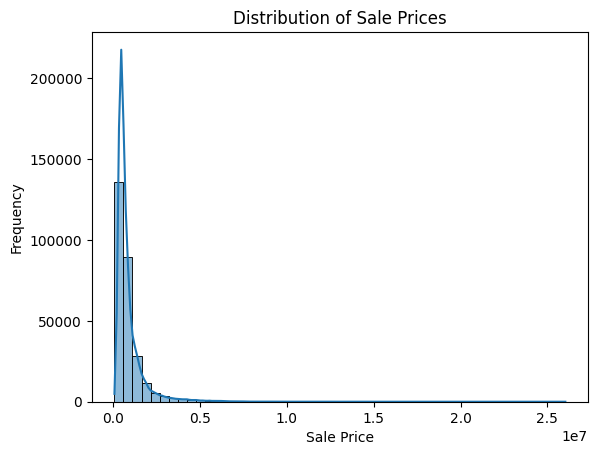

In [9]:
sns.histplot(data['saleEstimate_currentPrice'], kde=True, bins=50)
plt.title('Distribution of Sale Prices')
plt.xlabel('Sale Price')
plt.ylabel('Frequency')
plt.show()


C:\Users\25479\AppData\Local\Temp\ipykernel_17688\599173324.py:5: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(x='history_date', y='history_price', data=data, ci=None)


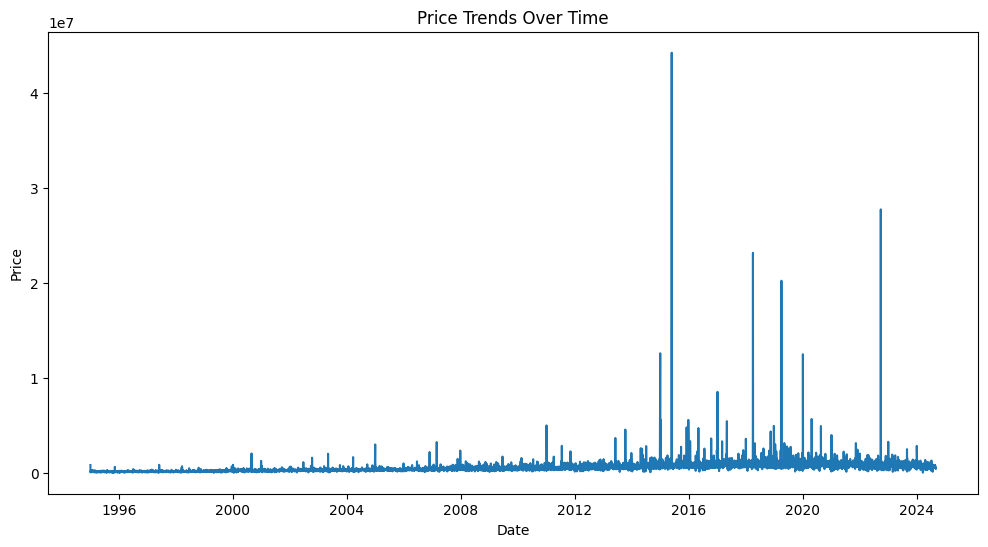

In [10]:
data['history_date'] = pd.to_datetime(data['history_date'])  # Ensure the column is datetime
data.sort_values(by='history_date', inplace=True)  # Sort by date

plt.figure(figsize=(12, 6))
sns.lineplot(x='history_date', y='history_price', data=data, ci=None)
plt.title('Price Trends Over Time')
plt.xlabel('Date')
plt.ylabel('Price')
plt.show()


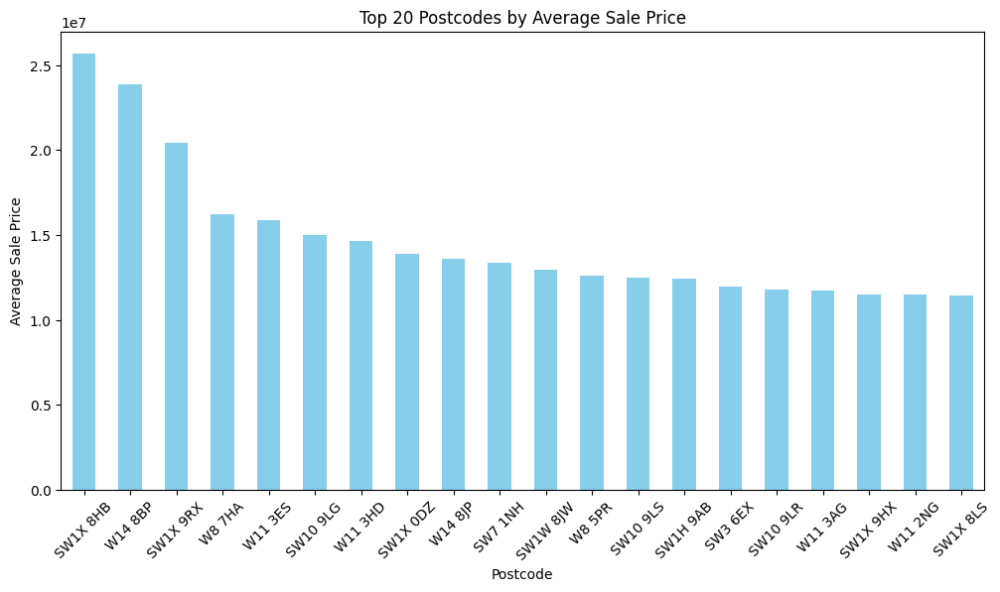

In [11]:
location_prices = data.groupby('postcode')['saleEstimate_currentPrice'].mean().sort_values(ascending=False).head(20)

plt.figure(figsize=(12, 6))
location_prices.plot(kind='bar', color='skyblue')
plt.title('Top 20 Postcodes by Average Sale Price')
plt.xlabel('Postcode')
plt.ylabel('Average Sale Price')
plt.xticks(rotation=45)
plt.show()


In [ ]:
fig = px.scatter_mapbox(
    data,  
    lat=data['latitude'],
    lon=data['longitude'],
    width=1000,  # Width of map
    height=600,  # Height of map
    color= "saleEstimate_currentPrice",
    hover_data=["saleEstimate_currentPrice"], 
)

fig.update_layout(mapbox_style="open-street-map")

fig.show()


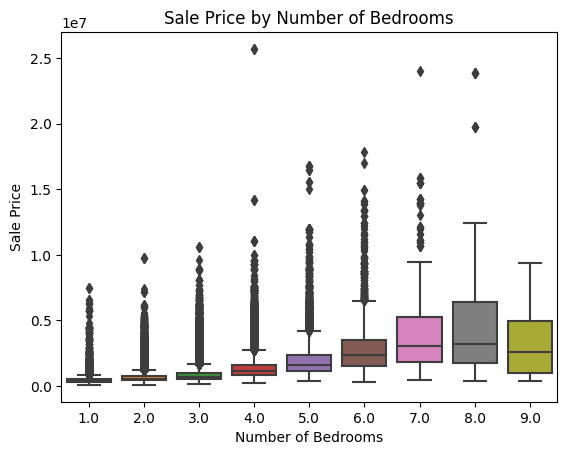

In [ ]:
sns.boxplot(x='bedrooms', y='saleEstimate_currentPrice', data=data)
plt.title('Sale Price by Number of Bedrooms')
plt.xlabel('Number of Bedrooms')
plt.ylabel('Sale Price')
plt.show()